In [1]:
# If you don't have PyQt5, please install it before you use it.
#!pip install mne
#!pip install PyQt5 
#!pip install -U scikit-learn
# you can interact with figure, especially EEG
import mne # process EEG
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [11]:
# set the working diretory
_thisdir = os.getcwd()
os.chdir(_thisdir)

# Preprocessing

Notice that all the steps in preprocessing can exchange their orders, cause all process is linear.


- read data
- set the channel type
- set the electrode location
- resample to 512 Hz
- filter 1-30 Hz   
- rereference
- remove ica components

## load eeg data

In [12]:
data_path = 'BIDS/sub-01/eeg/sub-01_task-GTDT_run-01_eeg.vhdr' 
# EEGLAB, '*.set': mne.io.read_raw_eeglab()
# BrainVision '*.vhdr': mne.io.read_raw_brainvision()
# BioSemi '*.bdf':mne.io.read_raw_bdf()
# Neuroscan '*.cnt':mne.io.read_raw_cnt()
raw = mne.io.read_raw_brainvision(data_path, preload=True)
# raw_copy = raw.copy()
raw.load_data()

Extracting parameters from BIDS/sub-01/eeg/sub-01_task-GTDT_run-01_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 1459799  =      0.000 ...  1459.799 secs...


Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,0.02 Hz
Lowpass,250.00 Hz


In [13]:
print(raw)

<RawBrainVision | sub-01_task-GTDT_run-01_eeg.eeg, 64 x 1459800 (1459.8 s), ~712.9 MB, data loaded>


In [14]:
print(raw.info)

<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F3, F4, C3, C4, P3, P4, O1, O2, F7, F8, T7, T8, P7, ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 250.0 Hz
 meas_date: 2023-08-18 13:57:02 UTC
 nchan: 64
 projs: []
 sfreq: 1000.0 Hz
>


In [6]:
raw.info['ch_names']

['Fp1',
 'Fp2',
 'F3',
 'F4',
 'C3',
 'C4',
 'P3',
 'P4',
 'O1',
 'O2',
 'F7',
 'F8',
 'T7',
 'T8',
 'P7',
 'P8',
 'Fz',
 'Cz',
 'Pz',
 'EOG',
 'FC1',
 'FC2',
 'CP1',
 'CP2',
 'FC5',
 'FC6',
 'CP5',
 'CP6',
 'FT9',
 'FT10',
 'TP9',
 'TP10',
 'F1',
 'F2',
 'C1',
 'C2',
 'P1',
 'P2',
 'AF3',
 'AF4',
 'FC3',
 'FC4',
 'CP3',
 'CP4',
 'PO3',
 'PO4',
 'F5',
 'F6',
 'C5',
 'C6',
 'P5',
 'P6',
 'AF7',
 'AF8',
 'FT7',
 'FT8',
 'TP7',
 'TP8',
 'PO7',
 'PO8',
 'Fpz',
 'CPz',
 'POz',
 'Oz']

## set the channel type

In [15]:
# set the channel type
raw.set_channel_types({'EOG':'eog'})

Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,Not available
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,0.02 Hz
Lowpass,250.00 Hz


## set the electrode location

In [16]:
raw.set_montage('standard_1020')

Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,0.02 Hz
Lowpass,250.00 Hz


In [9]:
mne.channels.make_standard_montage('standard_1020').ch_names

['Fp1',
 'Fpz',
 'Fp2',
 'AF9',
 'AF7',
 'AF5',
 'AF3',
 'AF1',
 'AFz',
 'AF2',
 'AF4',
 'AF6',
 'AF8',
 'AF10',
 'F9',
 'F7',
 'F5',
 'F3',
 'F1',
 'Fz',
 'F2',
 'F4',
 'F6',
 'F8',
 'F10',
 'FT9',
 'FT7',
 'FC5',
 'FC3',
 'FC1',
 'FCz',
 'FC2',
 'FC4',
 'FC6',
 'FT8',
 'FT10',
 'T9',
 'T7',
 'C5',
 'C3',
 'C1',
 'Cz',
 'C2',
 'C4',
 'C6',
 'T8',
 'T10',
 'TP9',
 'TP7',
 'CP5',
 'CP3',
 'CP1',
 'CPz',
 'CP2',
 'CP4',
 'CP6',
 'TP8',
 'TP10',
 'P9',
 'P7',
 'P5',
 'P3',
 'P1',
 'Pz',
 'P2',
 'P4',
 'P6',
 'P8',
 'P10',
 'PO9',
 'PO7',
 'PO5',
 'PO3',
 'PO1',
 'POz',
 'PO2',
 'PO4',
 'PO6',
 'PO8',
 'PO10',
 'O1',
 'Oz',
 'O2',
 'O9',
 'Iz',
 'O10',
 'T3',
 'T5',
 'T4',
 'T6',
 'M1',
 'M2',
 'A1',
 'A2']

In [17]:
all(channel in mne.channels.make_standard_montage('standard_1020').ch_names for channel in raw.copy().pick_types(eog=False, eeg=True).info.ch_names)

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


True

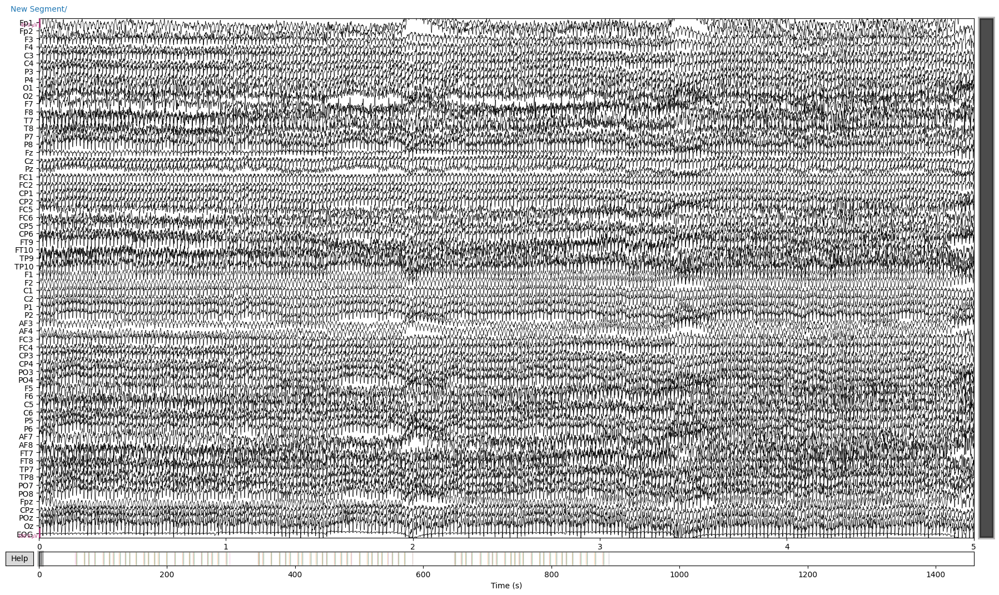

Channels marked as bad:
none


In [21]:
%matplotlib qt5 
raw.plot(duration=5, n_channels=64, clipping=None)

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 2.048 (s)


d:\Anaconda3\envs\PMPP\lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


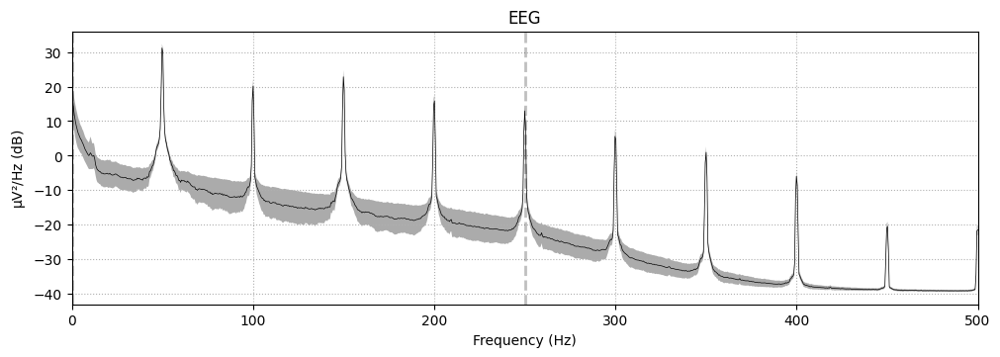

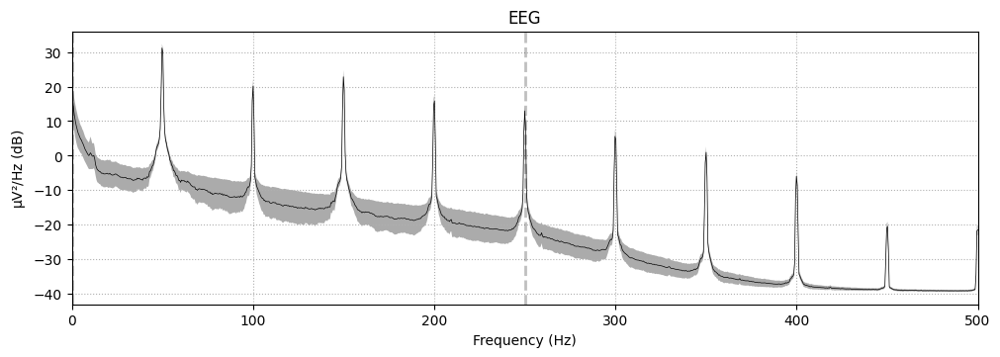

In [18]:
%matplotlib inline 
raw.plot_psd(average=True)

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 2.048 (s)


d:\Anaconda3\envs\PMPP\lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


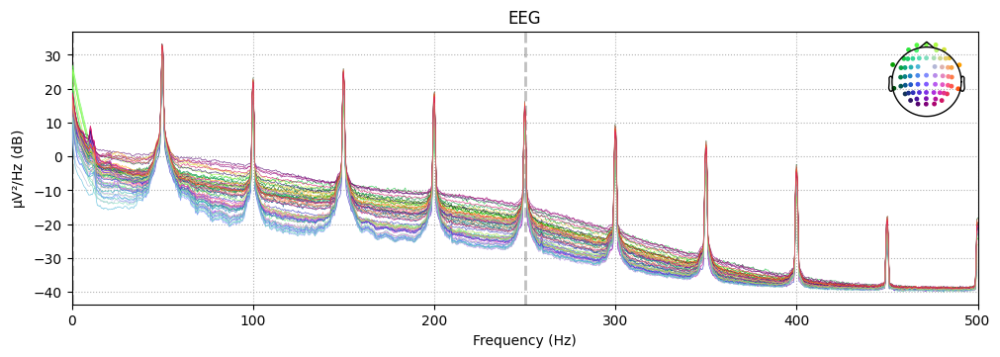

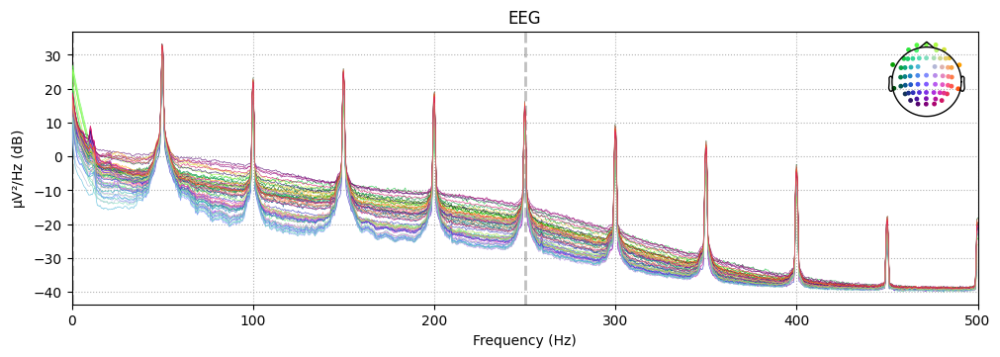

In [19]:
%matplotlib inline
raw.plot_psd(average=False)

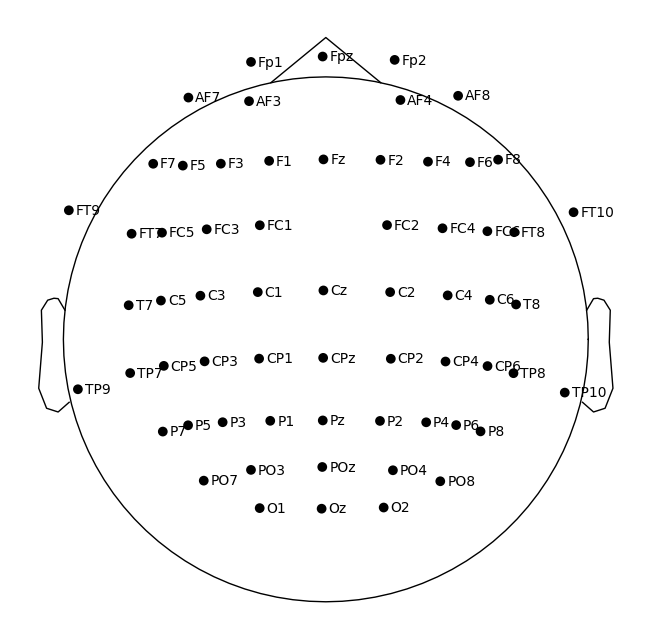

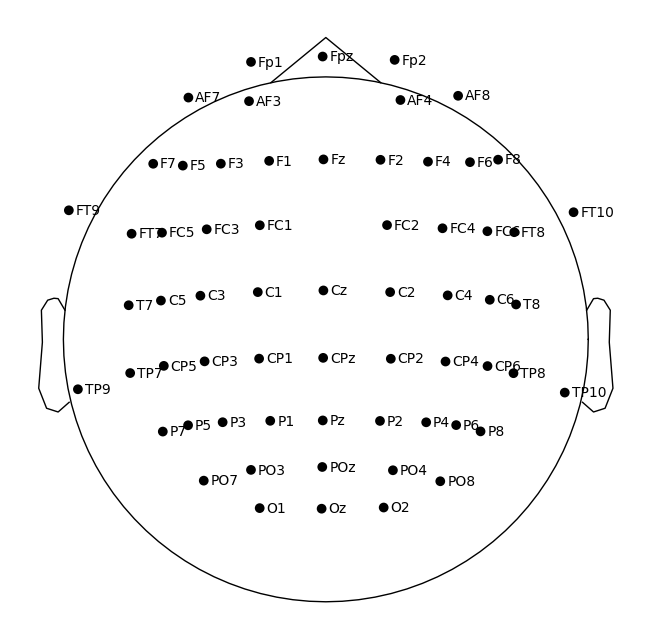

In [20]:
%matplotlib inline
raw.plot_sensors(ch_type='eeg', show_names=True)

NOTE: plot_psd_topo() is a legacy function. New code should use .compute_psd().plot_topo().
Effective window size : 2.048 (s)


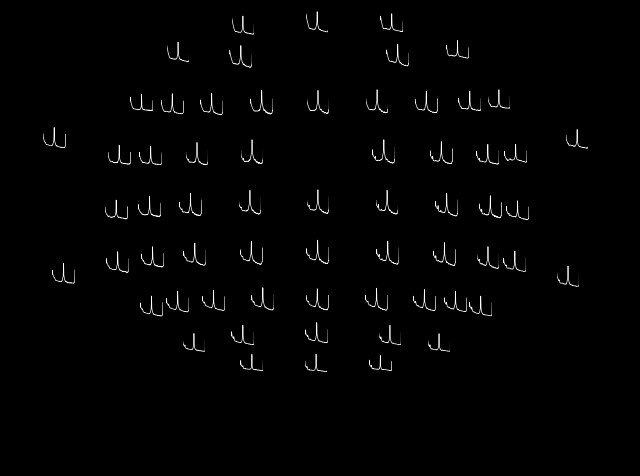

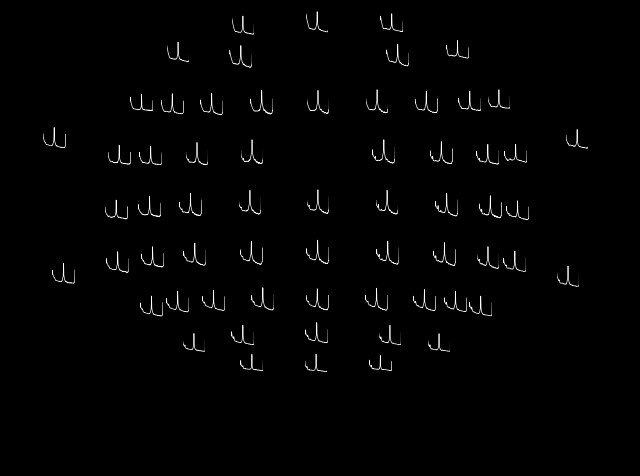

In [21]:
%matplotlib inline
raw.plot_psd_topo()

## resample to 512 Hz

In [22]:
raw.resample(512, npad="auto")

Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.02 Hz
Lowpass,250.00 Hz


In [23]:
print(raw)

<RawBrainVision | sub-01_task-GTDT_run-01_eeg.eeg, 64 x 747418 (1459.8 s), ~365.0 MB, data loaded>


In [24]:
print(raw.info)

<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F3, F4, C3, C4, P3, P4, O1, O2, F7, F8, T7, T8, P7, ...
 chs: 63 EEG, 1 EOG
 custom_ref_applied: False
 dig: 66 items (3 Cardinal, 63 EEG)
 highpass: 0.0 Hz
 lowpass: 250.0 Hz
 meas_date: 2023-08-18 13:57:02 UTC
 nchan: 64
 projs: []
 sfreq: 512.0 Hz
>


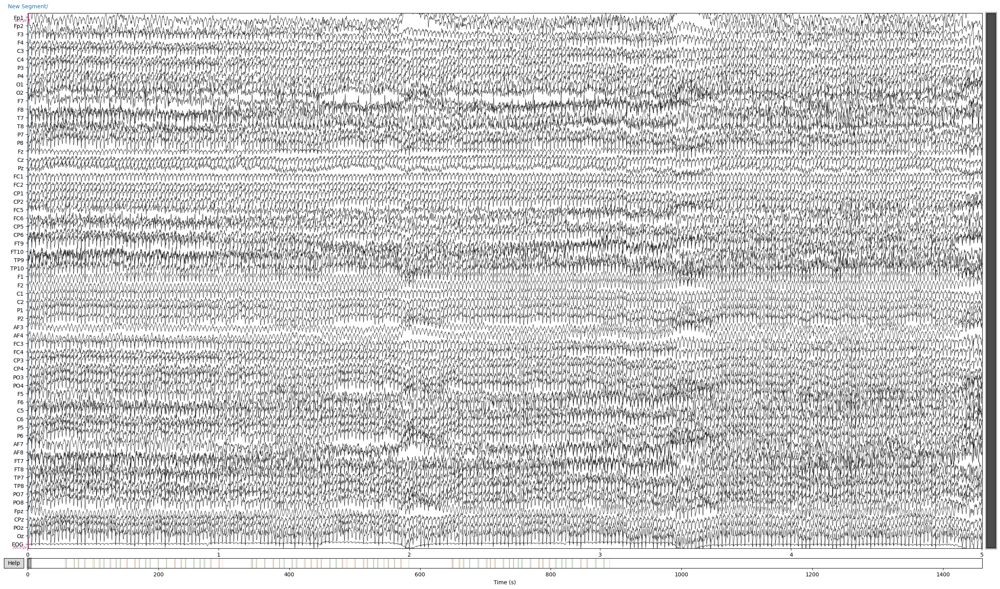

Channels marked as bad:
none


In [40]:
%matplotlib qt5 
raw.plot(duration=5, n_channels=64, clipping=None)

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.000 (s)


d:\Anaconda3\envs\PMPP\lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


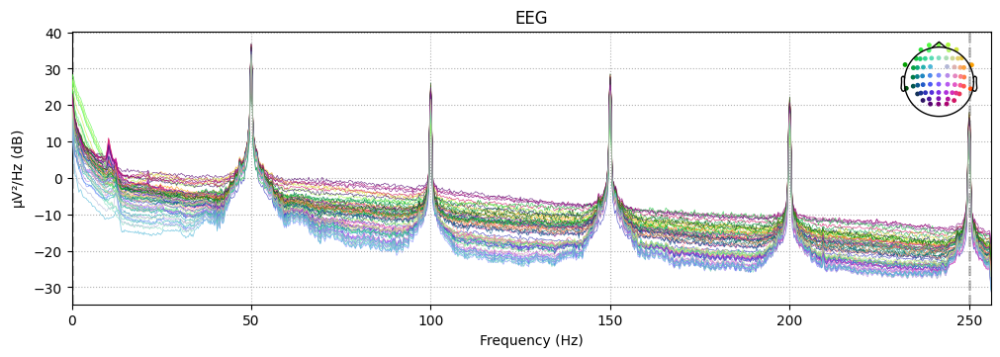

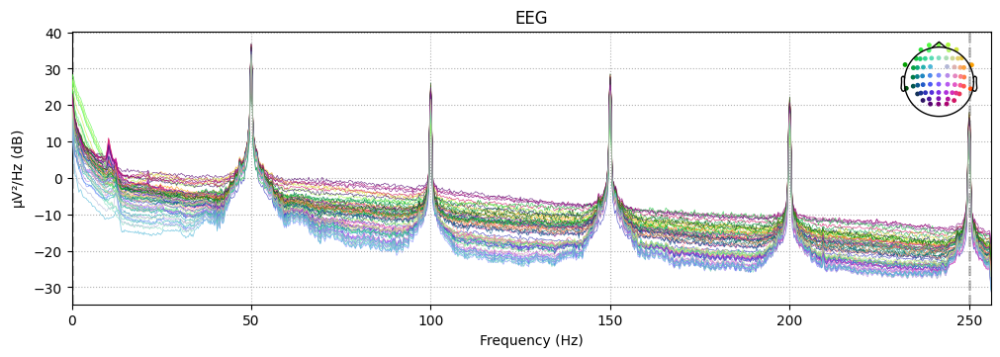

In [25]:
%matplotlib inline
raw.plot_psd(average=False)

## filter 

In [26]:
raw.notch_filter(picks=['eog', 'eeg'],freqs=(50))

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.02 Hz
Lowpass,250.00 Hz


NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.000 (s)


d:\Anaconda3\envs\PMPP\lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


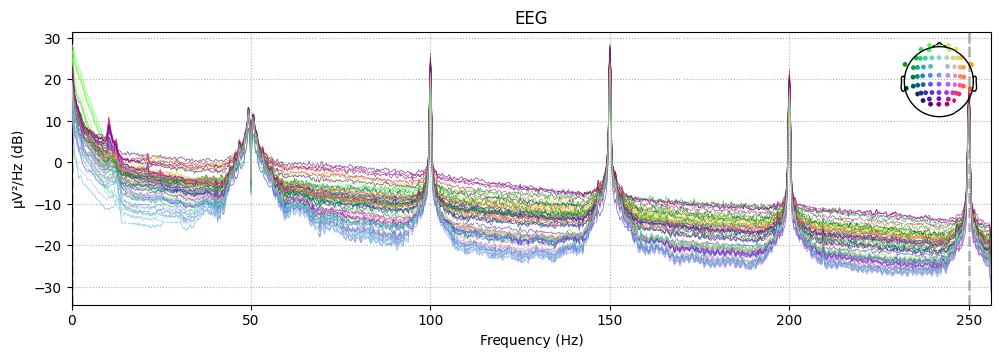

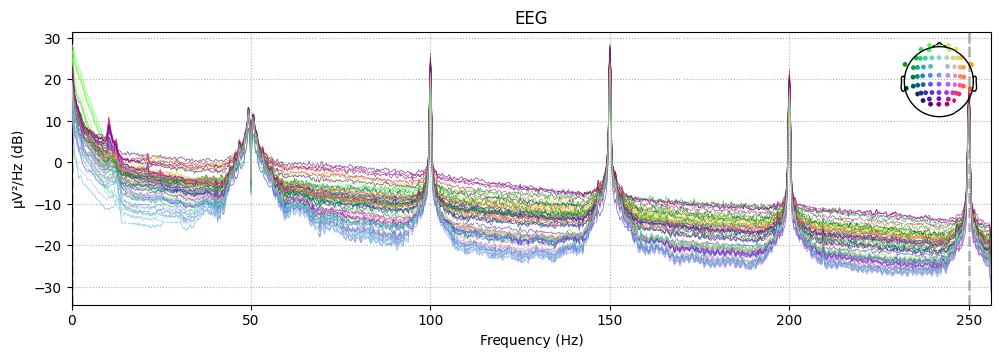

In [27]:
%matplotlib inline
raw.plot_psd(average=False)

In [28]:
raw.filter(picks=['eog', 'eeg'],l_freq=0.1, h_freq=30, method='iir')

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 0.10, 30.00 Hz: -6.02, -6.02 dB



Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.10 Hz
Lowpass,30.00 Hz


NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.000 (s)


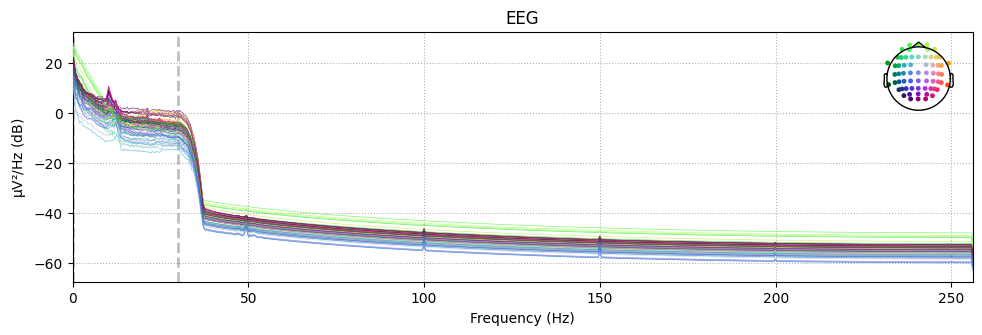

In [44]:
%matplotlib inline
raw.plot_psd(average=False)

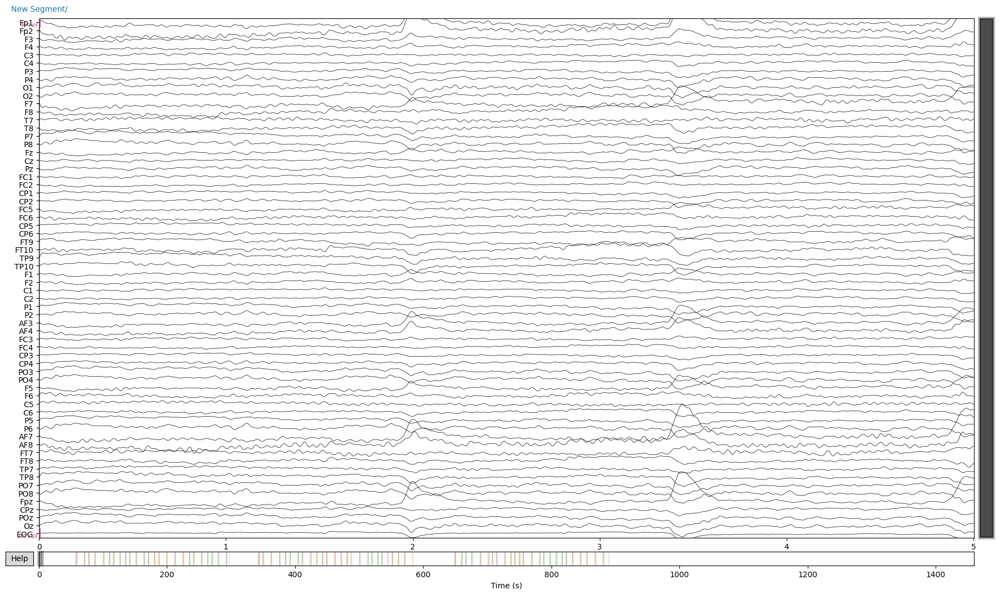

Channels marked as bad:
none


In [38]:
%matplotlib qt5
raw.plot(duration=5, n_channels=64, clipping=None)

## rereference

In [31]:
# rereference
raw.set_eeg_reference('average')
#raw.set_eeg_reference(ref_channels=['TP9','TP10'])

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.10 Hz
Lowpass,30.00 Hz


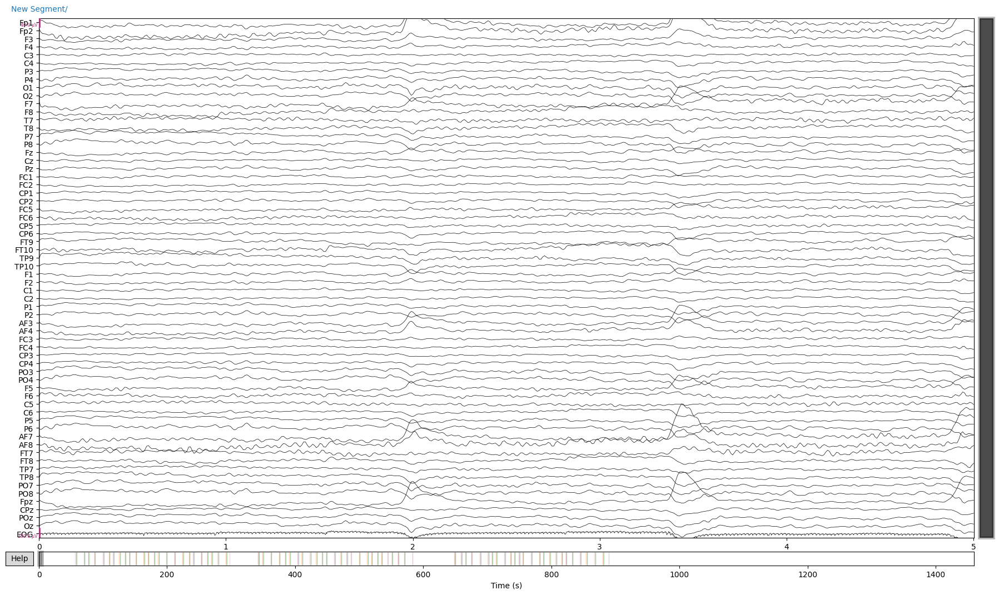

Channels marked as bad:
none


In [32]:
%matplotlib qt5
raw.plot(duration=5, n_channels=64, clipping=None)

## remove artifact

## remove bad channels

In [33]:
print(raw.info['bads'])

[]


In [34]:
raw_copy = raw.copy()

In [35]:
raw_copy.info['bads'].append('FC5')
# raw.info['bads'].remove('FC5')
print(raw_copy.info['bads'])

['FC5']


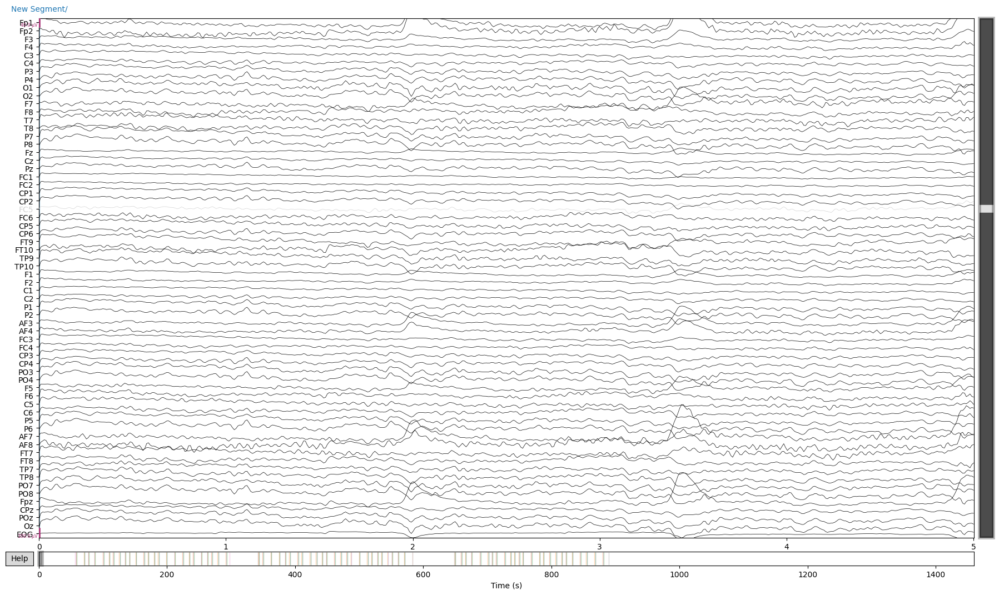

Channels marked as bad:
['FC5']


In [37]:
%matplotlib qt5
raw_copy.plot(duration=5, n_channels=64, clipping=None)

## recontrust bad channels

In [38]:
#raw_copy.interpolate_bads()
raw_copy.interpolate_bads(reset_bads=False)

Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 95.8 mm
Computing interpolation matrix from 62 sensor positions
Interpolating 1 sensors


Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"62 EEG, 1 EOG"
Bad channels,FC5
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.10 Hz
Lowpass,30.00 Hz


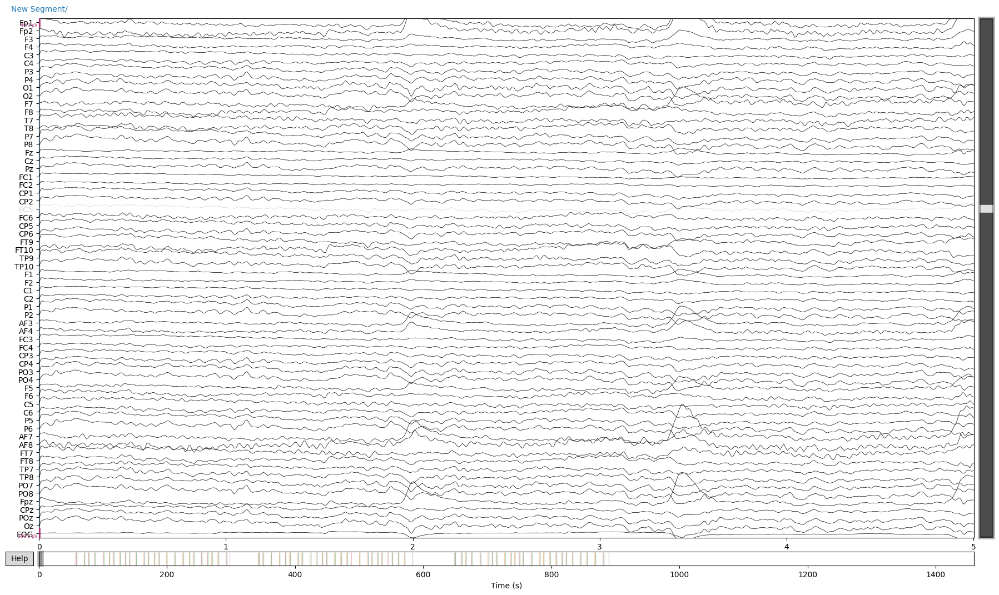

Channels marked as bad:
['FC5']


In [39]:
%matplotlib qt5
raw_copy.plot(duration=5, n_channels=64, clipping=None)

## ICA

In [45]:
# remove ica components
ica = mne.preprocessing.ICA(n_components=None, random_state=124,max_iter = 'auto')
raw_for_ica = raw.copy().filter(l_freq=1, h_freq=30)
ica.fit(raw_for_ica)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1691 samples (3.303 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


Fitting ICA to data using 63 channels (please be patient, this may take a while)
Selecting by non-zero PCA components: 63 components
Fitting ICA took 75.3s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,89 iterations on raw data (747418 samples)
ICA components,63
Available PCA components,63
Channel types,eeg
ICA components marked for exclusion,—


Creating RawArray with float64 data, n_channels=64, n_times=747418
    Range : 0 ... 747417 =      0.000 ...  1459.799 secs
Ready.


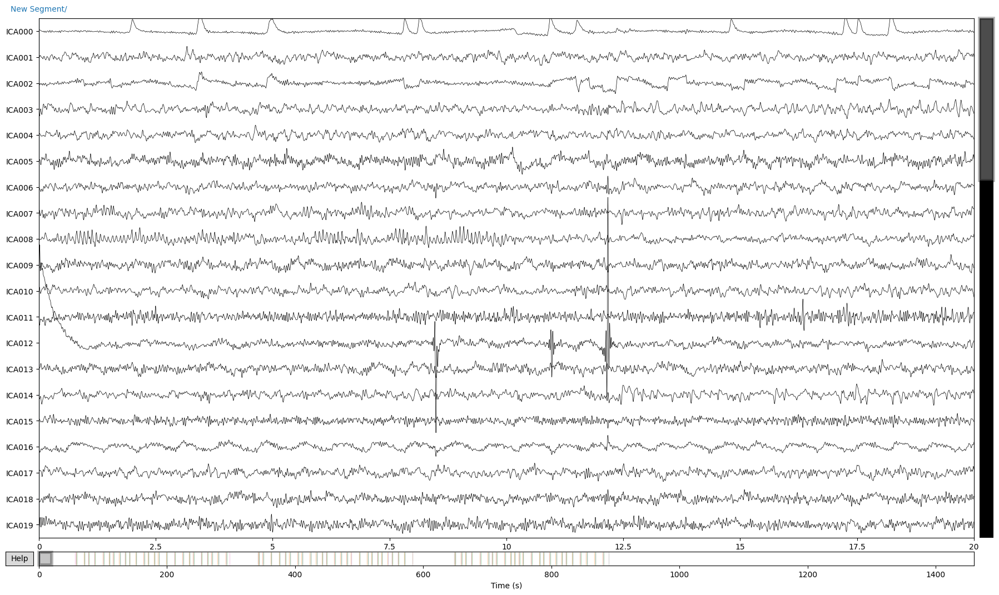

In [46]:
%matplotlib qt5
ica.plot_sources(raw_for_ica)

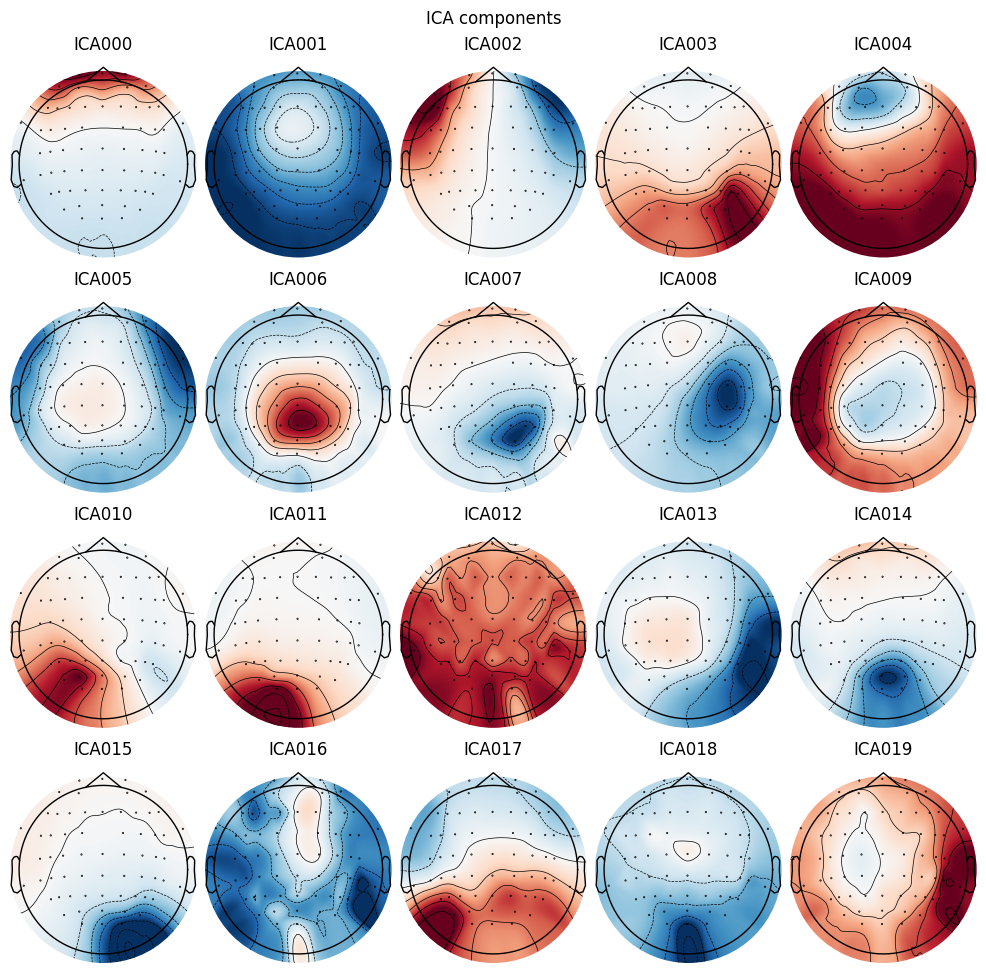

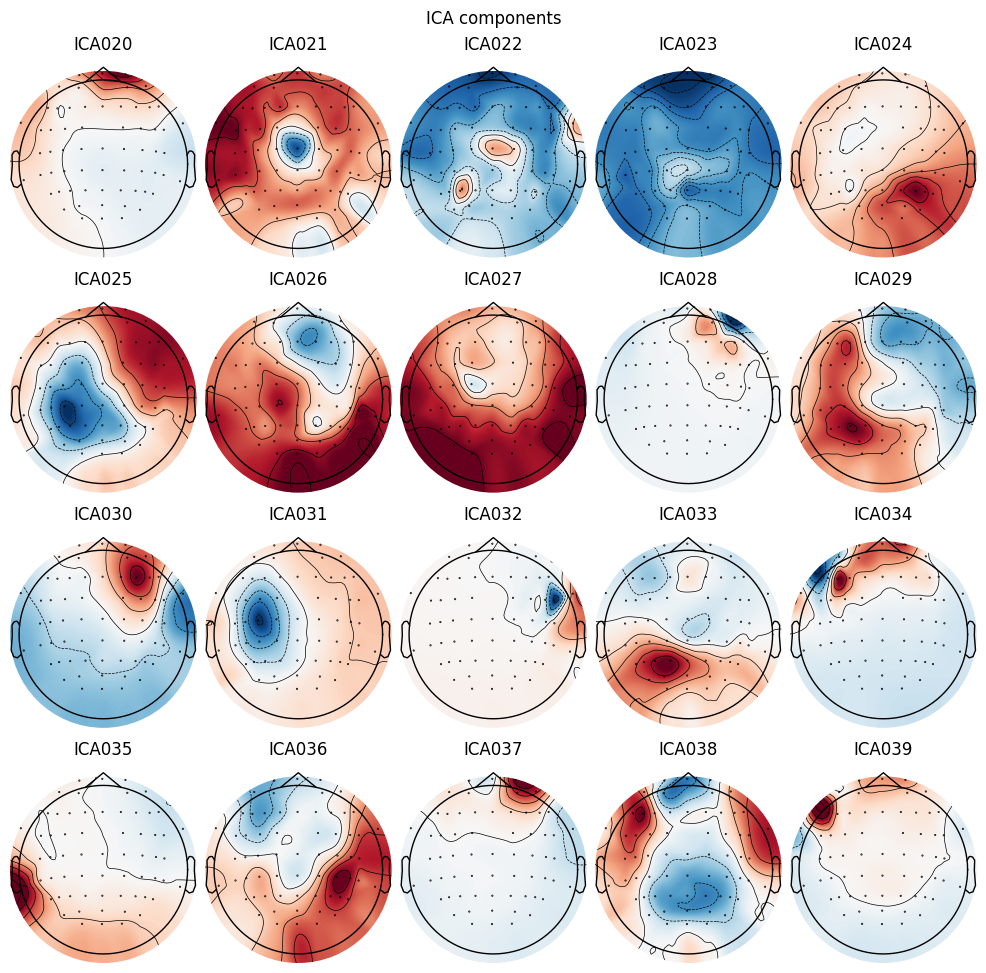

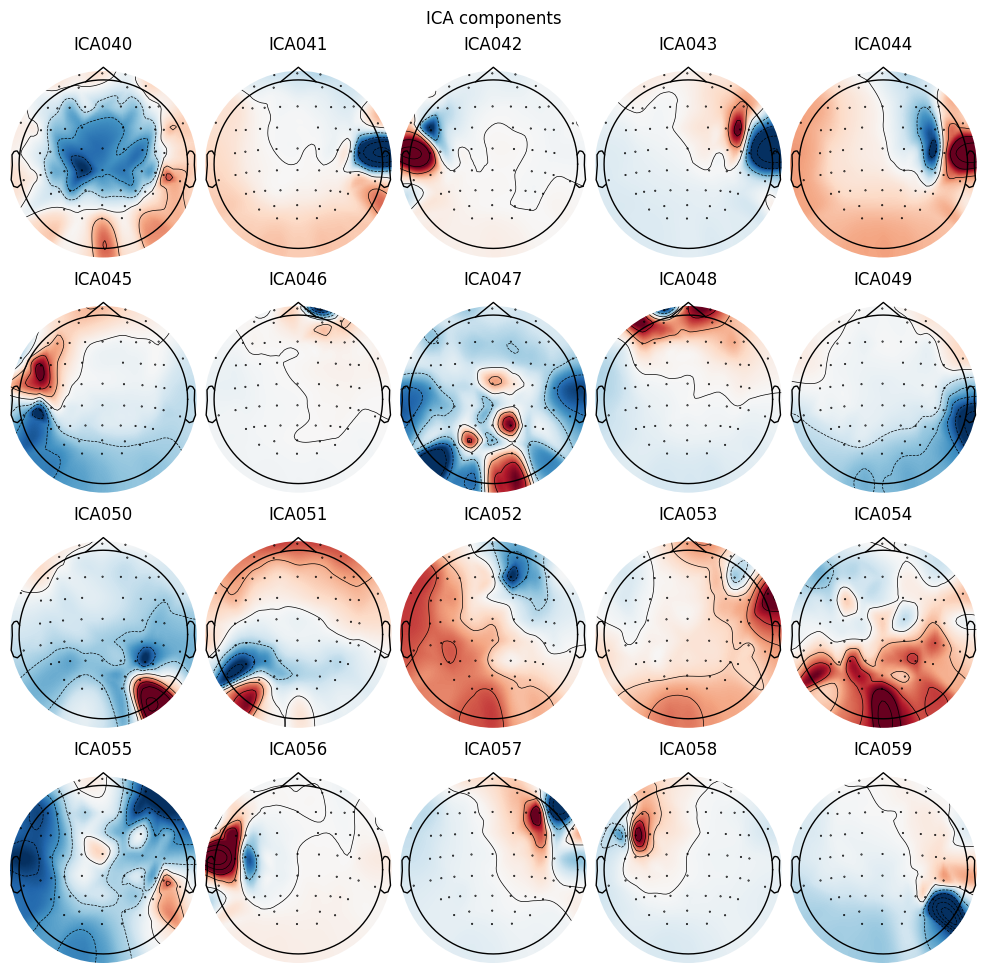

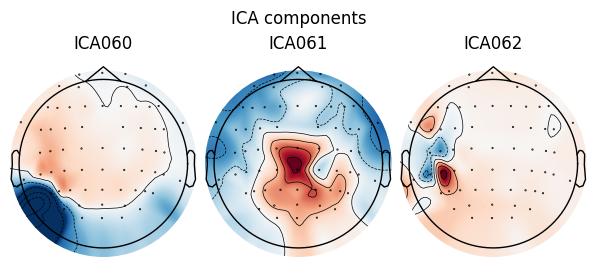

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 585x260.5 with 3 Axes>]

In [47]:
%matplotlib inline
ica.plot_components()

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
729 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
729 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
729 matching events found
No baseline correction applied
0 projection items activated


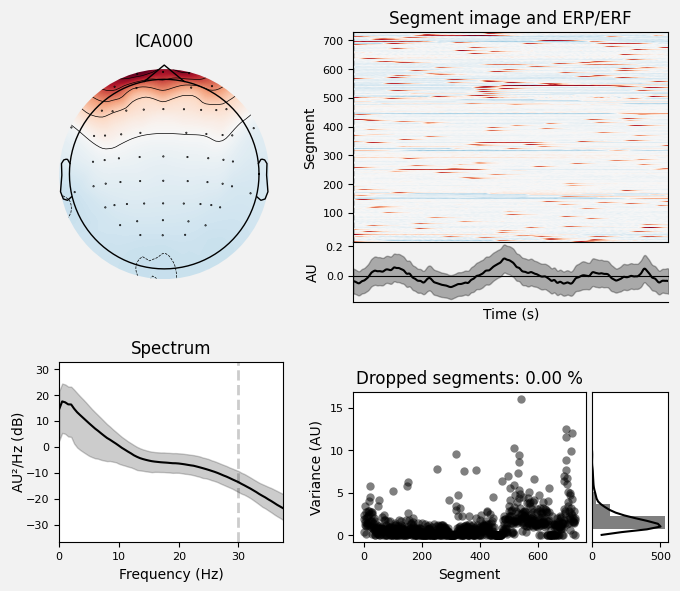

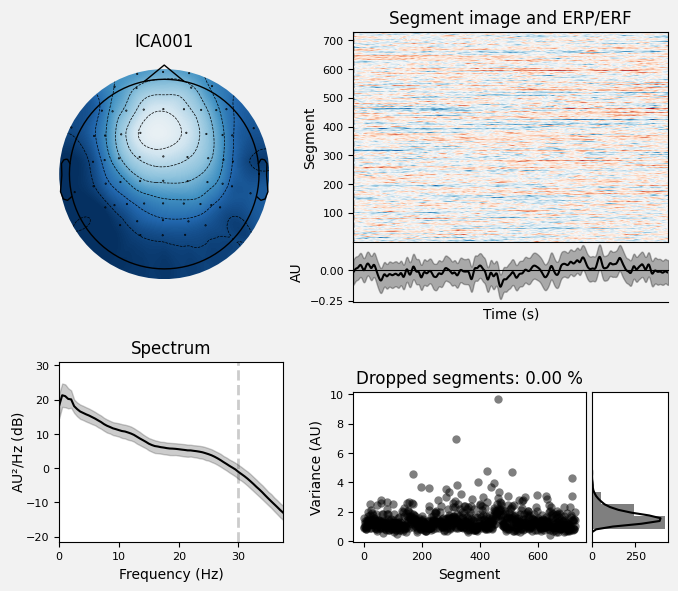

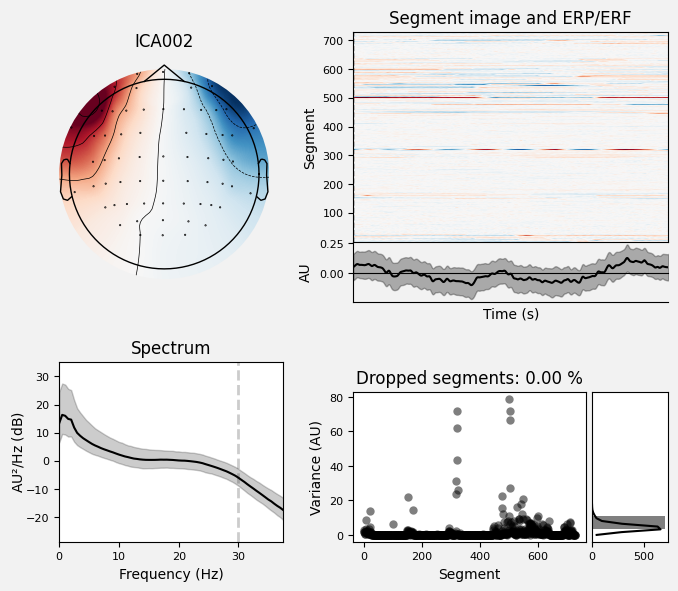

[<Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>]

In [48]:
%matplotlib inline
ica.plot_properties(raw, picks=[0, 1,2])

Applying ICA to Raw instance
    Transforming to ICA space (63 components)
    Zeroing out 3 ICA components
    Projecting back using 63 PCA components


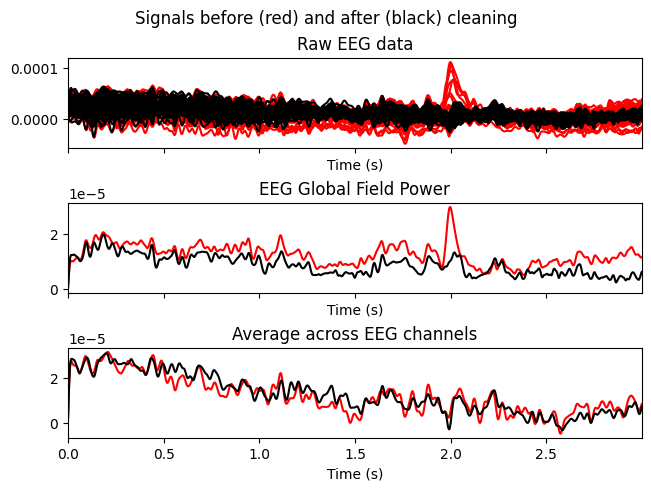

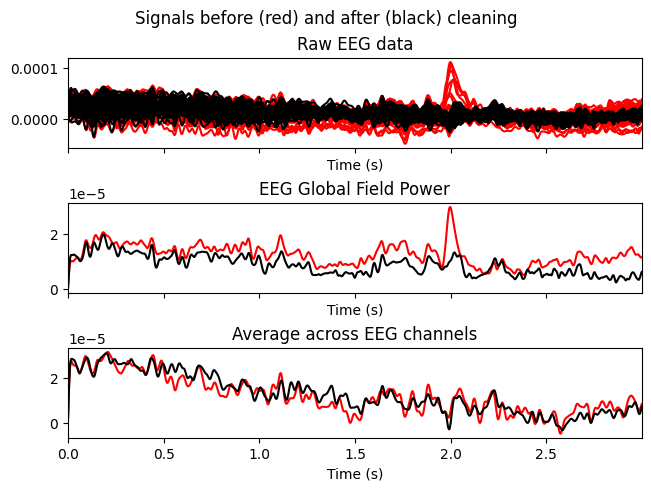

In [49]:
%matplotlib inline
ica.plot_overlay(raw, exclude=[0,1,2])

In [50]:
ica.exclude = [0,1,2]
ica.apply(raw)

Applying ICA to Raw instance
    Transforming to ICA space (63 components)
    Zeroing out 3 ICA components
    Projecting back using 63 PCA components


Measurement date,"August 18, 2023 13:57:02 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,66 points
Good channels,"63 EEG, 1 EOG"
Bad channels,None
EOG channels,EOG
ECG channels,Not available
Sampling frequency,512.00 Hz
Highpass,0.10 Hz
Lowpass,30.00 Hz


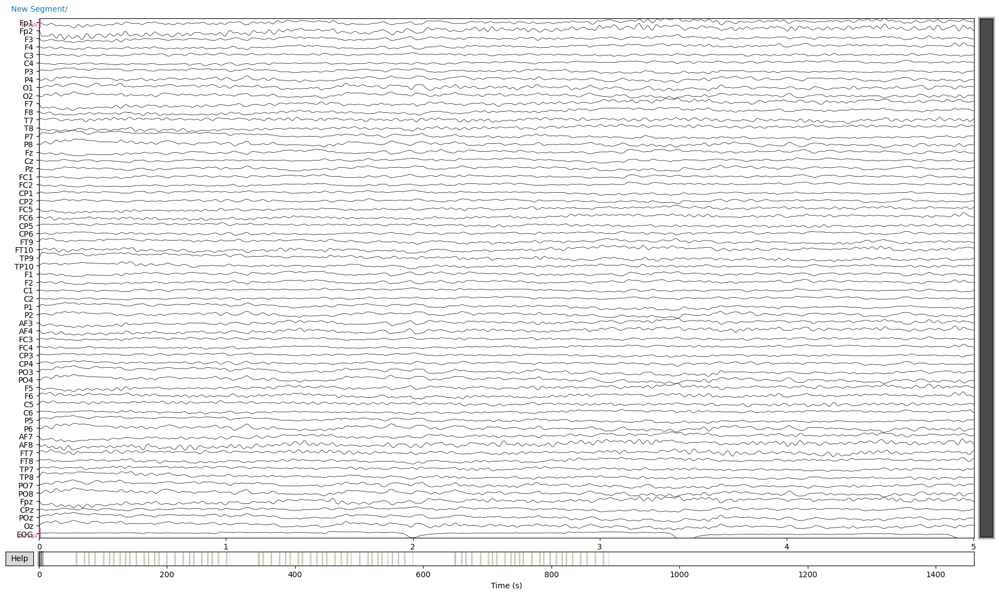

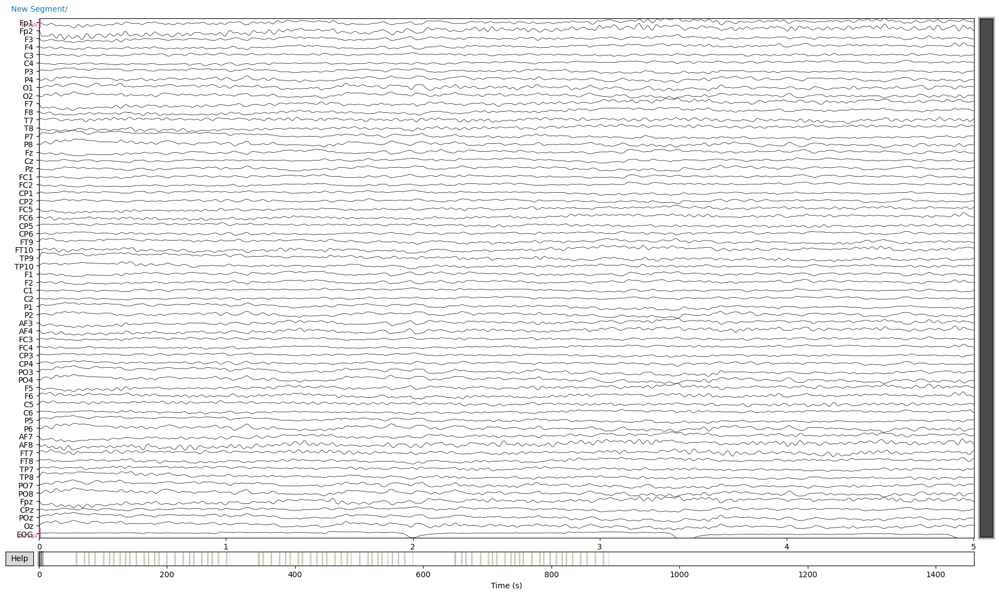

In [60]:
%matplotlib qt5
raw.plot(duration=5, n_channels=64, clipping=None)

In [51]:
ica.exclude = []                                   
eog_indices, eog_scores = ica.find_bads_eog(raw_for_ica)                               
ica.exclude = eog_indices
#ica.apply(raw)

Using EOG channel: EOG
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5120 samples (10.000 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5120 samples (10.000 s)



In [52]:
print(eog_indices)
print(eog_scores)

[0]
[-7.85825731e-01 -1.35414304e-01 -1.94673560e-01  1.14398600e-02
  5.21003212e-02 -1.80832287e-01 -3.15514111e-03 -2.38123256e-03
  3.23343732e-03  6.94454718e-02 -1.04345007e-02 -1.06160884e-02
  3.00049064e-02 -7.72955931e-03 -4.22794529e-02 -1.03449257e-02
 -1.51893048e-02 -5.57084559e-02 -1.34399570e-02  4.23492551e-02
  3.29170048e-02  2.30156522e-02 -1.25859403e-02 -1.32071838e-02
  2.38560786e-02  1.45962976e-02  1.30757526e-02  2.42317341e-03
 -3.84187428e-02 -1.82536045e-02 -1.12071172e-02  4.45807495e-03
  8.79441350e-03 -2.91878738e-03 -3.98148728e-02  3.62074813e-02
 -2.21259386e-03 -3.70021979e-02  2.34682123e-03  6.92492386e-02
  9.29457741e-03  3.30820735e-02  2.69139437e-02 -3.16650043e-02
  4.69644682e-02 -2.84622617e-02 -1.48311364e-02 -2.81211951e-02
 -1.49508879e-02 -2.67192619e-02  2.05990934e-02  1.51680156e-02
  4.87573870e-03 -4.53568422e-03 -6.52611516e-04 -2.89999908e-02
 -6.56838554e-03 -7.74399636e-02 -2.28691640e-02 -5.05161761e-03
 -2.11452623e-02 -1.7

# segment epochs

After we have preprocessed the data, we segment epochs and see the basic result of the epochs. According to the marker, the epochs can be seen as the different types, such as the circlr-locked, square-locked, response locked epochs. In each epochs, we will see the single-trial images, erp of all trials and erp of average trials.

- set event marker
- circlr-locked
- square-locked
- response locked

In [53]:
print(raw.annotations)
print(raw.annotations.duration)
print(raw.annotations.description)
print(raw.annotations.onset)

<Annotations | 230 segments: New Segment/ (1), Stimulus/S 1 (75), ...>
[0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.00

In [54]:
events, event_id = mne.events_from_annotations(raw)

Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1', 'Stimulus/S  2', 'Stimulus/S  9', 'Stimulus/S111', 'Stimulus/S112', 'Stimulus/S113']


In [55]:
print(events.shape, event_id)

(230, 3) {'New Segment/': 99999, 'Stimulus/S  1': 1, 'Stimulus/S  2': 2, 'Stimulus/S  9': 9, 'Stimulus/S111': 111, 'Stimulus/S112': 112, 'Stimulus/S113': 113}


In [56]:
print(events)

[[     0      0  99999]
 [ 29052      0    112]
 [ 29569      0      1]
 [ 29967      0      9]
 [ 30265      0      2]
 [ 36126      0      1]
 [ 36278      0      9]
 [ 36466      0      2]
 [ 39407      0      1]
 [ 39610      0      9]
 [ 39798      0      2]
 [ 44329      0      1]
 [ 44582      0      9]
 [ 44799      0      2]
 [ 50889      0      1]
 [ 51549      0      9]
 [ 51870      0      2]
 [ 55807      0      1]
 [ 56418      0      9]
 [ 56636      0      2]
 [ 59088      0      1]
 [ 59598      0      9]
 [ 59855      0      2]
 [ 64012      0      1]
 [ 64670      0      9]
 [ 64864      0      2]
 [ 68933      0      1]
 [ 69084      0      9]
 [ 69270      0      2]
 [ 72212      0      1]
 [ 72416      0      9]
 [ 72586      0      2]
 [ 77128      0      1]
 [ 77688      0      9]
 [ 77885      0      2]
 [ 83685      0      1]
 [ 83986      0      9]
 [ 84225      0      2]
 [ 86966      0      1]
 [ 87425      0      9]
 [ 87631      0      2]
 [ 91882      0 

In [57]:
# set the marker
stim_ids = {'Stimulus/S  1':1} # the marker of circle onset
resp_ids = {'Stimulus/S  2':2} # the marker of response
sq_ids = {'Stimulus/S  9':9} # the marker of square onset

## circlr-locked cpp


- epoch
- topomap
- single trial image
- erp

### epoch

In [58]:
# circle onset-locked epochs
tmin, tmax = -0.75, 2 # the time segment for epochs 
baseline = (-0.5, 0) # the time window for baseline correction
epochs_stim = mne.Epochs(raw, events, stim_ids, tmin=tmin,picks='eeg', tmax=tmax, baseline=baseline,preload=True) 
#epochs_stim = mne.Epochs(raw, events, stim_ids, tmin=tmin,picks='eeg', tmax=tmax, baseline=baseline,preload=True, reject=dict(eeg=2e-4)) 

Not setting metadata
75 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 75 events and 1409 original time points ...
0 bad epochs dropped


In [59]:
print(epochs_stim)

<Epochs |  75 events (all good), -0.75 – 2 s, baseline -0.5 – 0 s, ~50.9 MB, data loaded,
 'Stimulus/S  1': 75>


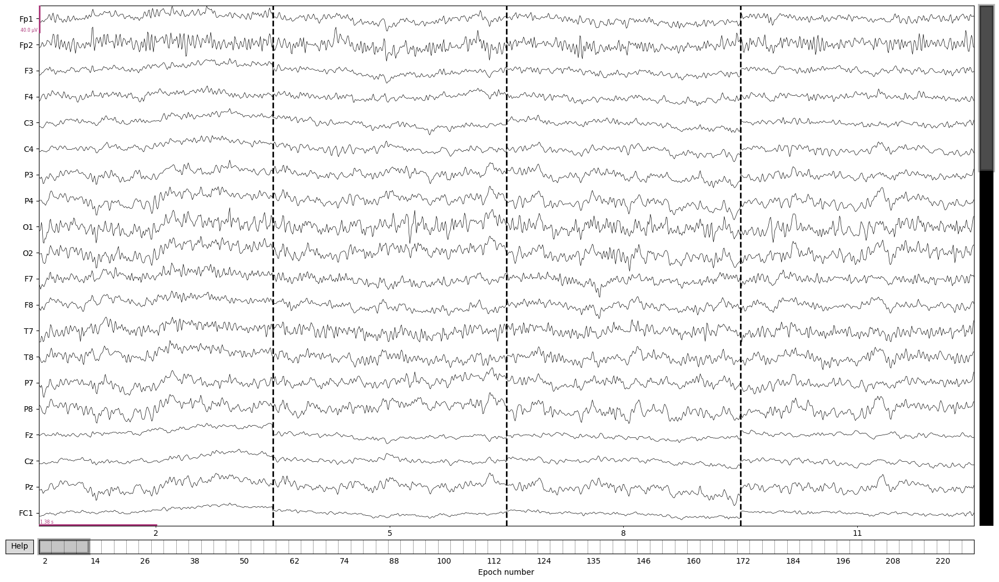

Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
none


In [ ]:
%matplotlib qt5
epochs_stim.plot(n_epochs=4)

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
    Using multitaper spectrum estimation with 7 DPSS windows
Averaging across epochs...


d:\Anaconda3\envs\PMPP\lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


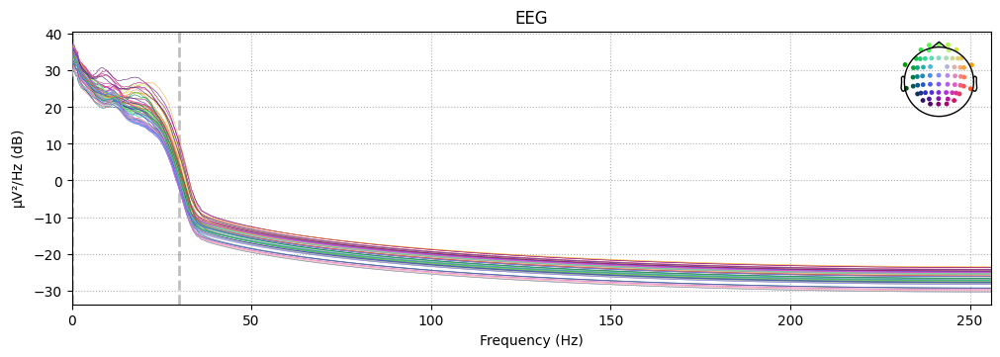

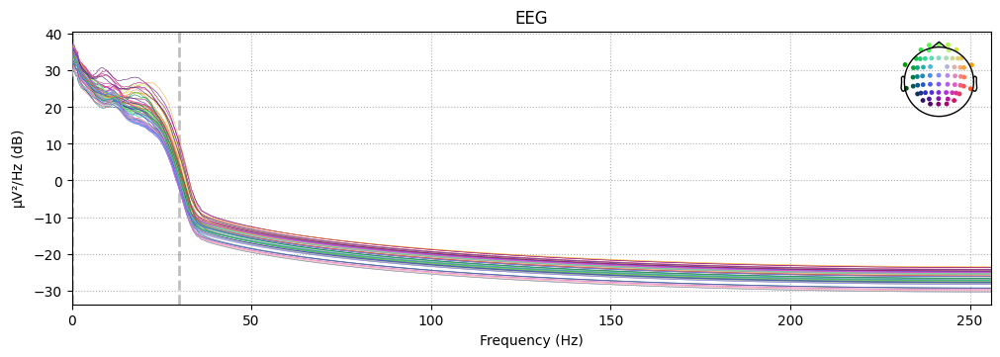

In [88]:
%matplotlib inline
epochs_stim.plot_psd(picks='eeg')

NOTE: plot_psd_topomap() is a legacy function. New code should use .compute_psd().plot_topomap().
    Using multitaper spectrum estimation with 7 DPSS windows
converting legacy list-of-tuples input to a dict for the `bands` parameter


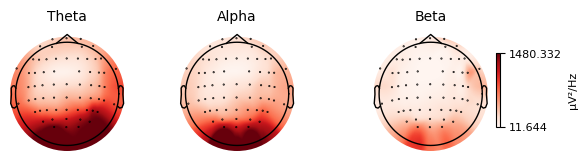

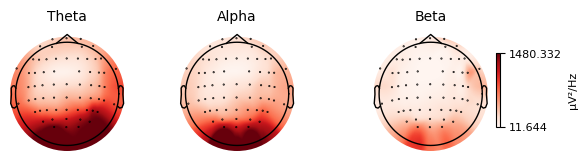

In [61]:
%matplotlib inline
bands = [(4, 8, 'Theta'), (8, 12, 'Alpha'), (12, 30, 'Beta')]
epochs_stim.plot_psd_topomap(bands=bands, vlim='joint')

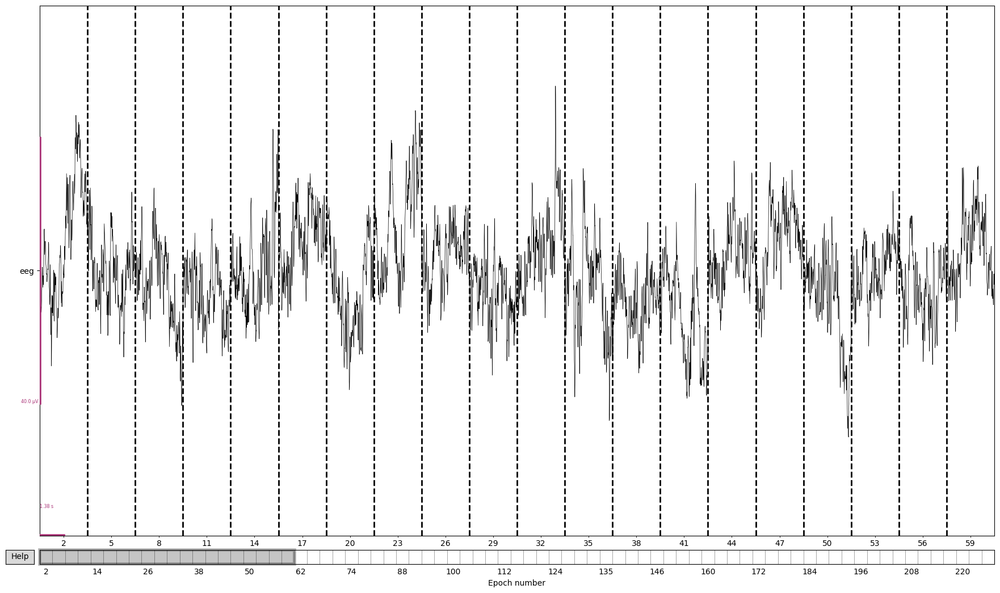

Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
none


In [80]:
%matplotlib qt5
epochs_stim.plot(picks=['CPz'])

Need more than one channel to make topography for eeg. Disabling interactivity.


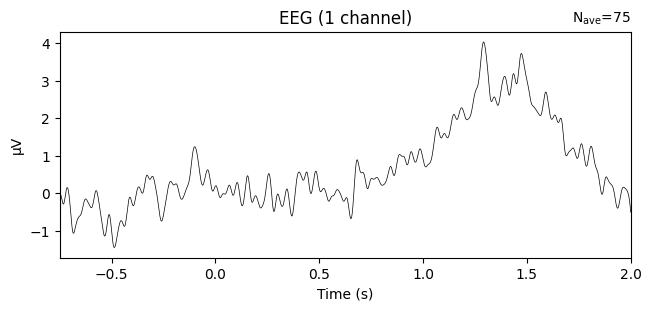

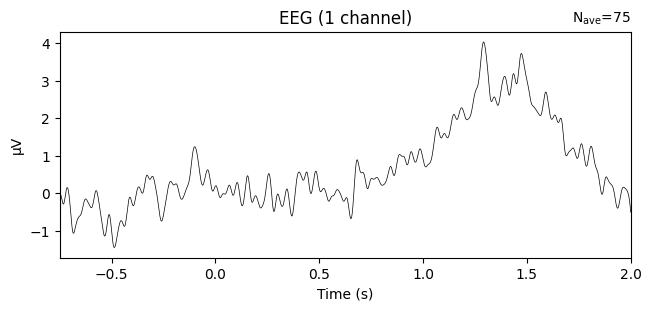

In [82]:
%matplotlib inline
evoked_stim = epochs_stim.average()
evoked_stim.plot(picks=['CPz'])

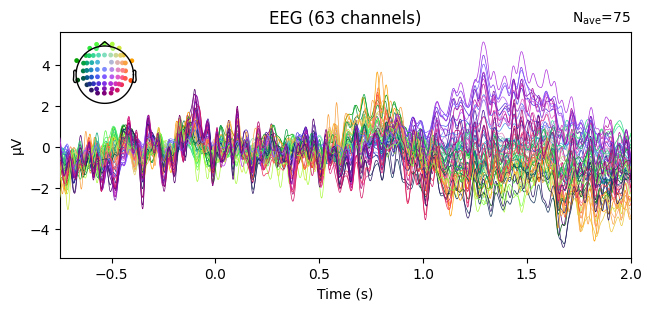

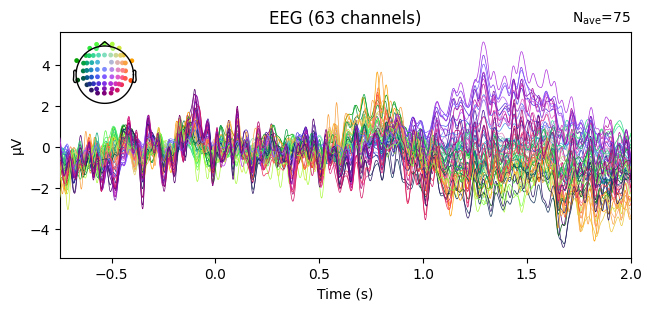

In [83]:
%matplotlib inline
evoked_stim = epochs_stim.average()
evoked_stim.plot()

### topomap

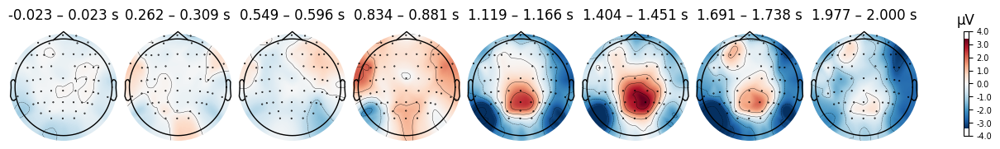

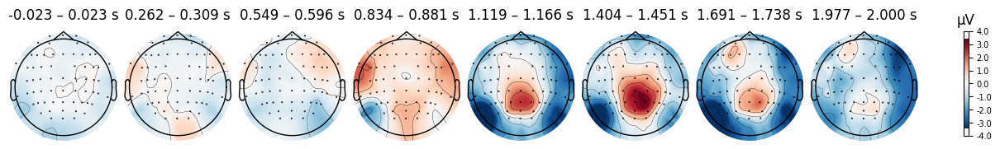

In [84]:
%matplotlib inline
times = np.linspace(0, 2, 8)
evoked_stim.plot_topomap(times=times,average=0.05)

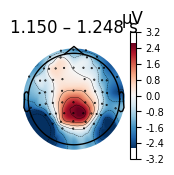

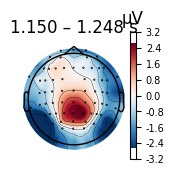

In [85]:
%matplotlib inline
evoked_stim.plot_topomap(times=1.2, average=0.1)

No projector specified for this dataset. Please consider the method self.add_proj.


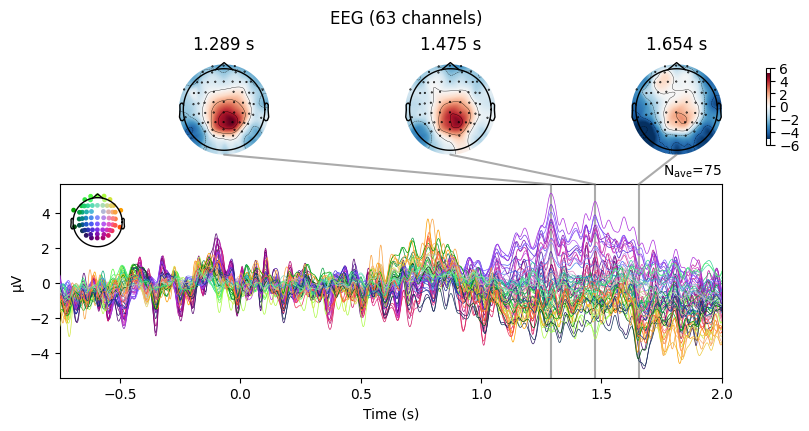

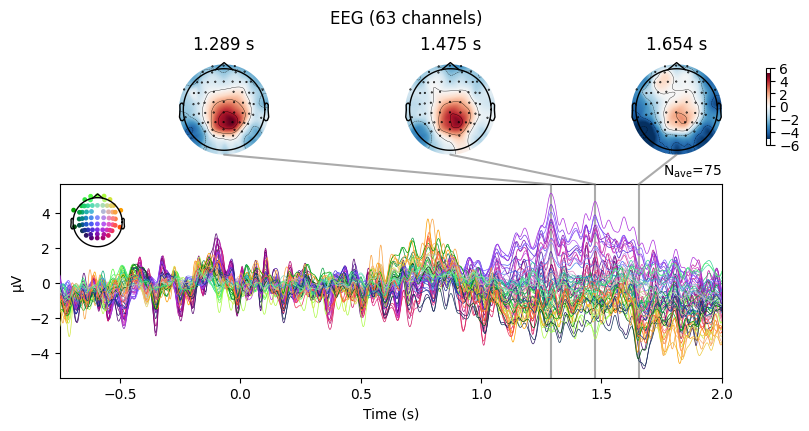

In [86]:
%matplotlib inline
evoked_stim.plot_joint()

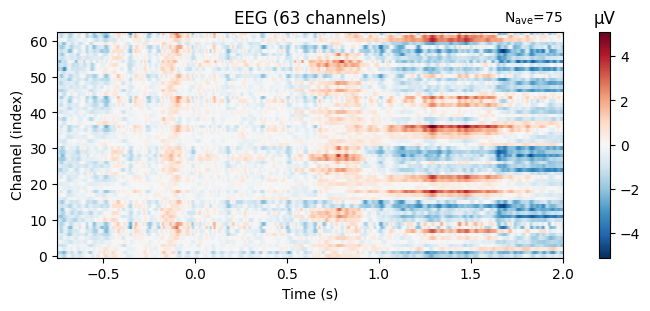

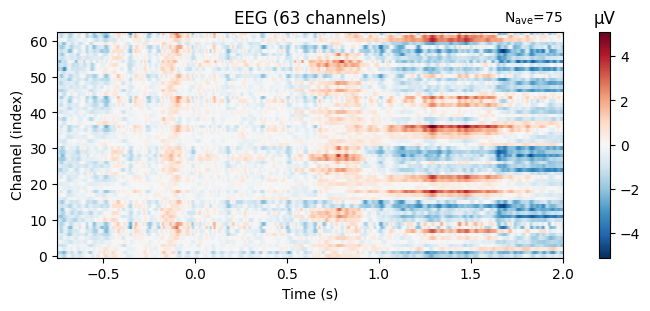

In [87]:
%matplotlib inline
evoked_stim.plot_image()

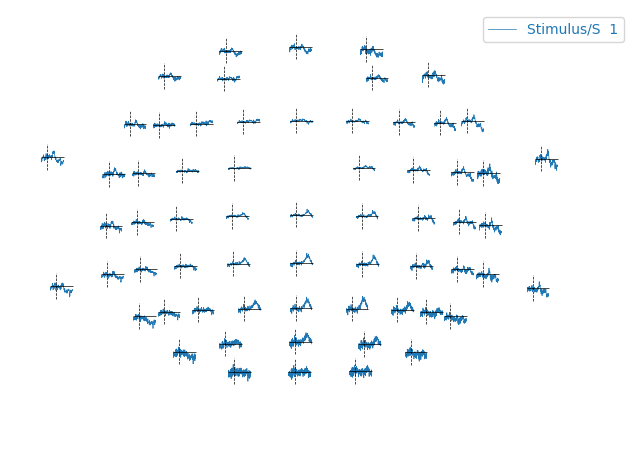

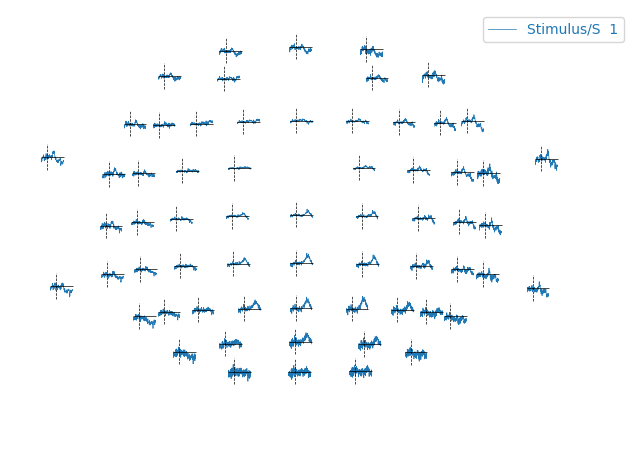

In [88]:
%matplotlib inline
evoked_stim.plot_topo()

combining channels using "mean"


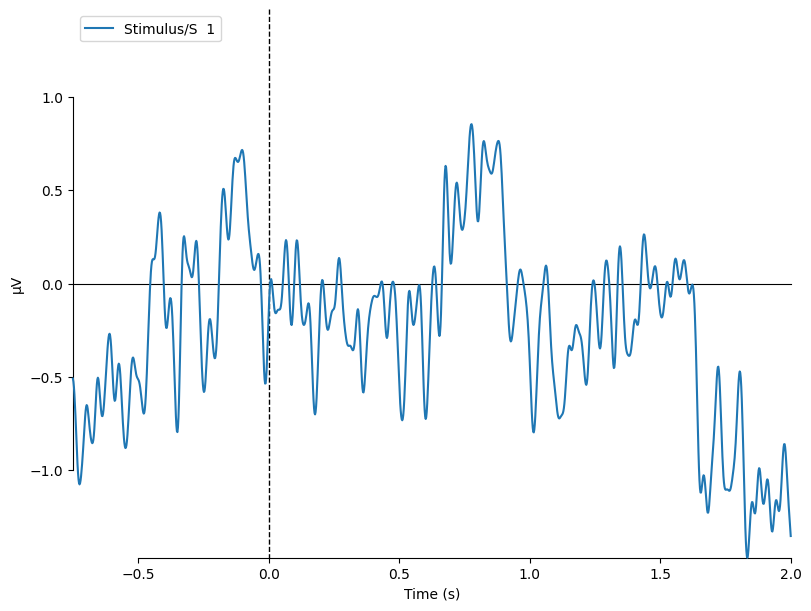

[<Figure size 800x600 with 1 Axes>]

In [89]:
%matplotlib inline
mne.viz.plot_compare_evokeds(evokeds=evoked_stim, combine='mean')

# erp

combining channels using "mean"


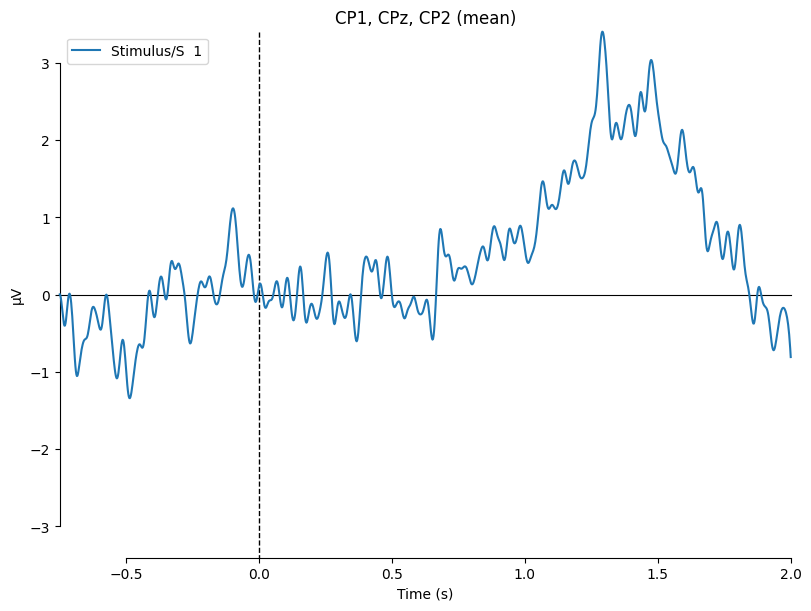

[<Figure size 800x600 with 1 Axes>]

In [90]:
%matplotlib inline
mne.viz.plot_compare_evokeds(evokeds=evoked_stim, picks=['CP1', 'CPz', 'CP2'], combine='mean')

In [91]:
filename_beh = 'BIDS/sub-01/beh/sub-01_task-GTDT_run-01_beh.csv' 
dfs_stim = pd.read_csv(filename_beh,sep=',',index_col=0) 
rts = dfs_stim.loc[dfs_stim['RtTimes']==1,'Rt'].reset_index(drop=True).replace(np.nan,0) # get the rt of first response and replace NA to 0

Not setting metadata
75 matching events found
No baseline correction applied
0 projection items activated
combining channels using "mean"


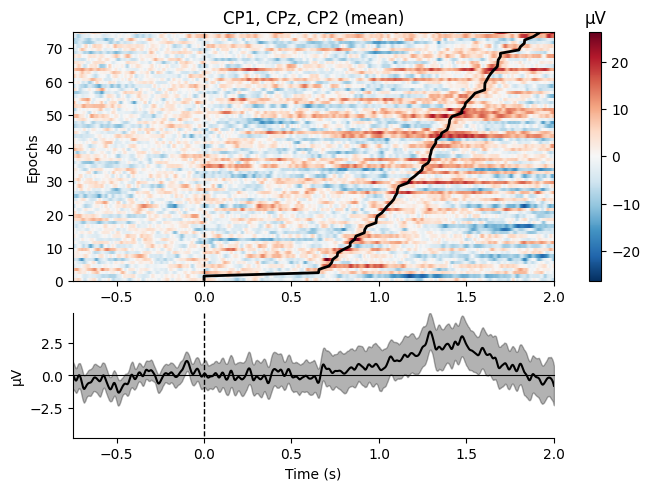

[<Figure size 640x480 with 3 Axes>]

In [92]:
epochs_stim.plot_image(picks=['CP1', 'CPz', 'CP2'],order= rts.argsort(),overlay_times=rts,combine="mean")

## data

In [72]:
evoked_stim_copy = evoked_stim.copy()
evoked_stim_copy.pick_channels(['CP1', 'CPz', 'CP2']).crop(tmin=1,tmax=1.5)

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


C:\Users\User\AppData\Local\Temp\ipykernel_8184\798517683.py:2: FutureWarning: The default for pick_channels will change from ordered=False to ordered=True in 1.5 and this will result in a change of behavior because the resulting channel order will not match. Either use a channel order that matches your instance or pass ordered=False.
  evoked_stim_copy.pick_channels(['CP1', 'CPz', 'CP2']).crop(tmin=1,tmax=1.5)


Condition,Stimulus/S 1
Data kind,average
Timepoints,257 samples
Channels,3 channels
Number of averaged epochs,75
Time range (secs),1.0 – 1.5
Baseline (secs),-0.500 – 0.000 s


In [73]:
evoked_stim_copy.data.shape

(3, 257)

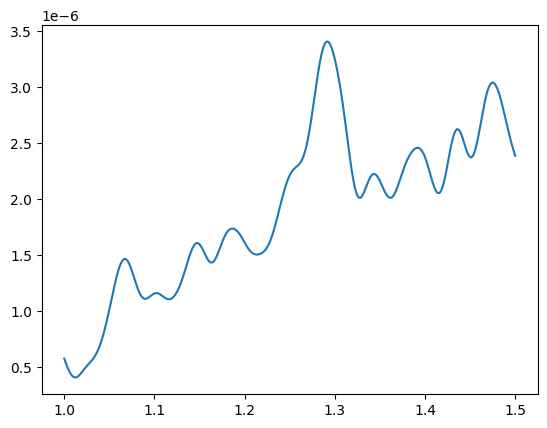

In [129]:
evoked_stim_copy_data = np.mean(evoked_stim_copy.data, axis=0)
plt.plot(np.arange(len(evoked_stim_copy_data))/512+1,evoked_stim_copy_data)

# Time-frequency

In [114]:
freqs = np.logspace(*np.log10([4, 30]), num=10)
n_cycles = freqs / 2
power, itc = mne.time_frequency.tfr_morlet(epochs_stim, freqs=freqs, n_cycles=n_cycles, use_fft=True,average=True)

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s


In [94]:
print(power)
print(itc)

<AverageTFR | time : [-0.750000, 2.000000], freq : [4.000000, 30.000000], nave : 75, channels : 63, ~6.9 MB>
<AverageTFR | time : [-0.750000, 2.000000], freq : [4.000000, 30.000000], nave : 75, channels : 63, ~6.9 MB>


Applying baseline correction (mode: logratio)


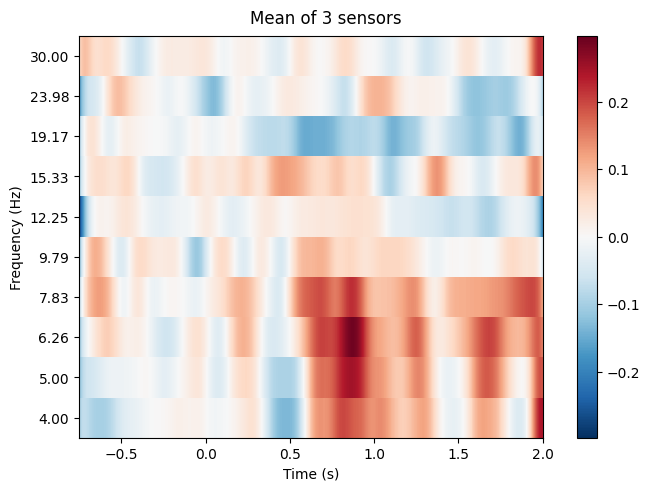

[<Figure size 640x480 with 2 Axes>]

In [95]:
#'mean'
#'ratio'
#'logratio'
#'percent'
#'zscore'
#'zlogratio'
power.plot(picks=['CP1', 'CPz', 'CP2'], baseline=baseline, mode='logratio', title='auto', combine='mean')

Applying baseline correction (mode: logratio)


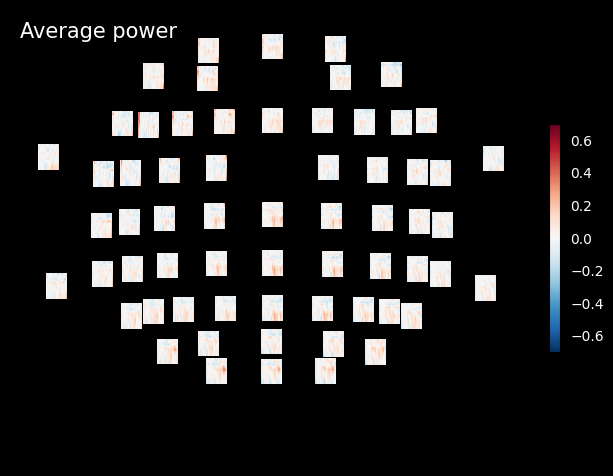

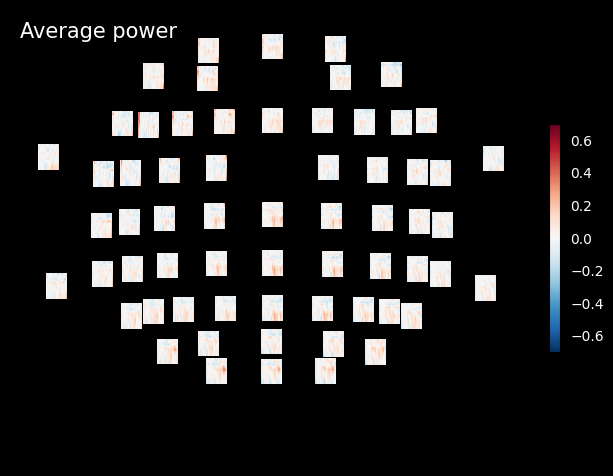

In [96]:
power.plot_topo(baseline=(-0.5, 0), mode='logratio', title='Average power')

Applying baseline correction (mode: logratio)


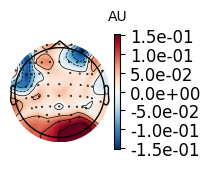

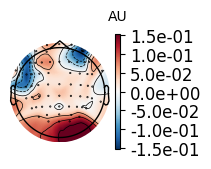

In [97]:
power.plot_topomap(tmin=1, tmax=1.5, fmin=22, fmax=24, 
                   baseline=baseline, mode='logratio')

Applying baseline correction (mode: logratio)


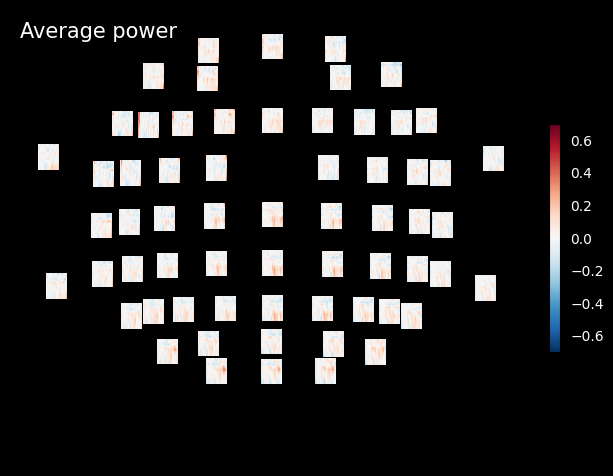

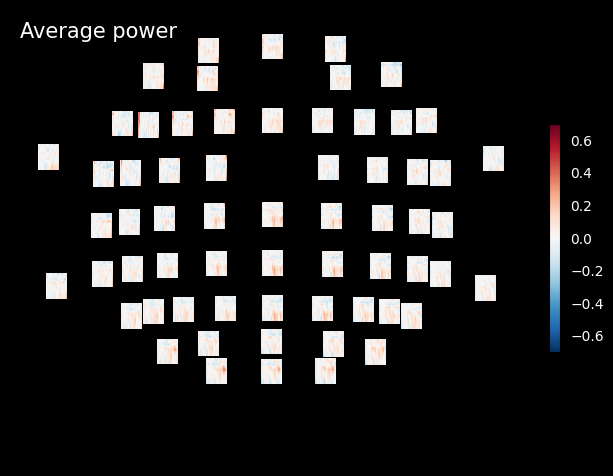

In [98]:
power.plot_topo(baseline=(-0.5, 0), mode='logratio', title='Average power')

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


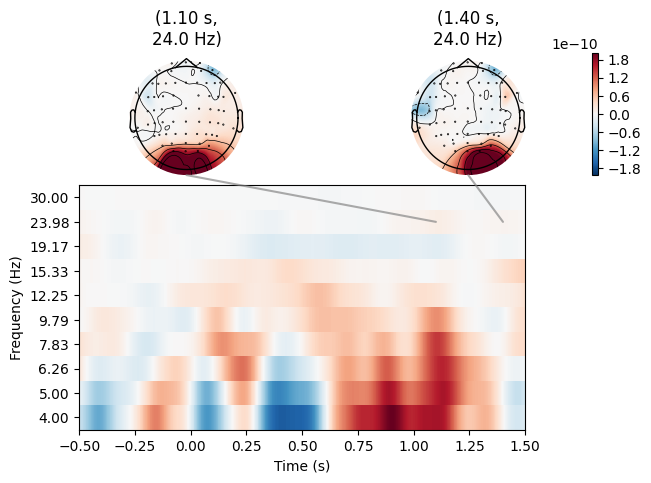

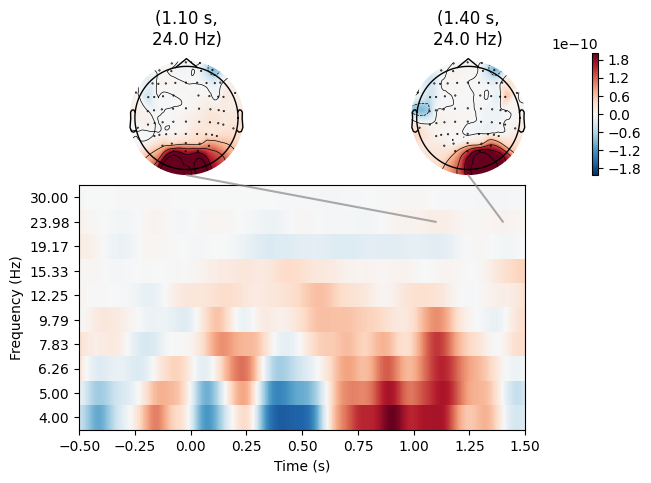

In [99]:
power.plot_joint(baseline=(-0.5, 0), mode='mean', tmin=-0.5, tmax=1.5,
                 timefreqs=[(1.1, 22), (1.4, 24)])

Applying baseline correction (mode: logratio)


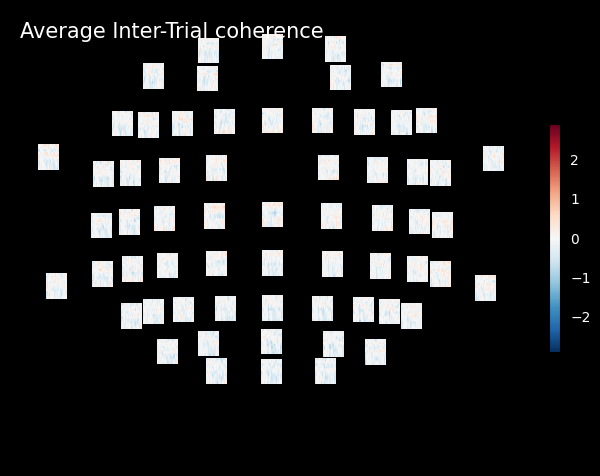

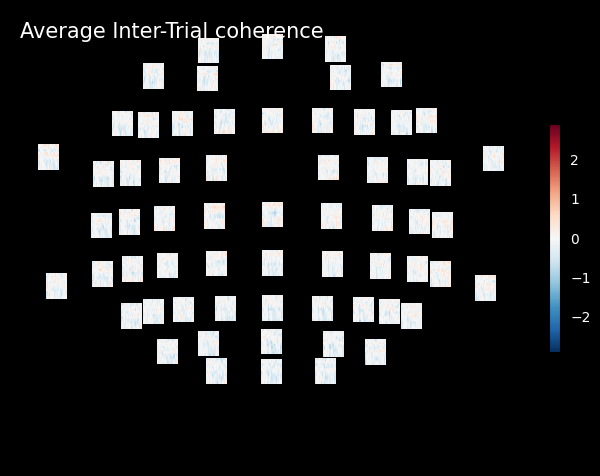

In [100]:
itc.plot_topo(baseline=(-0.5, 0), mode='logratio', title='Average Inter-Trial coherence')

In [101]:
power.to_data_frame()

,time,freq,Fp1,Fp2,F3,F4,C3,C4,P3,P4,...,FT7,FT8,TP7,TP8,PO7,PO8,Fpz,CPz,POz,Oz
0,-0.750000,4.0,5.893624e-10,8.072661e-10,4.107982e-10,2.864999e-10,2.849833e-10,3.531698e-10,7.668366e-10,9.725506e-10,...,6.501217e-10,8.583380e-10,8.034166e-10,1.026044e-09,1.202509e-09,1.314567e-09,7.219687e-10,5.056348e-10,1.122932e-09,1.236552e-09
1,-0.748047,4.0,5.934366e-10,8.107179e-10,4.165757e-10,2.897476e-10,2.868918e-10,3.581548e-10,7.758359e-10,9.836105e-10,...,6.553682e-10,8.666549e-10,8.094552e-10,1.036866e-09,1.213297e-09,1.329023e-09,7.255219e-10,5.107574e-10,1.133723e-09,1.248648e-09
2,-0.746094,4.0,5.969487e-10,8.134179e-10,4.220469e-10,2.927984e-10,2.885548e-10,3.629157e-10,7.842698e-10,9.939809e-10,...,6.600467e-10,8.743051e-10,8.147385e-10,1.046941e-09,1.223061e-09,1.342566e-09,7.283842e-10,5.154171e-10,1.143598e-09,1.259737e-09
3,-0.744141,4.0,5.999031e-10,8.153845e-10,4.272054e-10,2.956533e-10,2.899781e-10,3.674517e-10,7.921447e-10,1.003671e-09,...,6.641667e-10,8.812988e-10,8.192777e-10,1.056282e-09,1.231819e-09,1.355208e-09,7.305680e-10,5.196140e-10,1.152571e-09,1.269830e-09
4,-0.742188,4.0,6.023068e-10,8.166393e-10,4.320457e-10,2.983142e-10,2.911691e-10,3.717634e-10,7.994705e-10,1.012695e-09,...,6.677404e-10,8.876493e-10,8.230878e-10,1.064906e-09,1.239592e-09,1.366970e-09,7.320885e-10,5.233502e-10,1.160658e-09,1.278943e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14085,1.992188,30.0,2.447284e-11,5.393604e-11,1.866223e-11,1.938875e-11,1.608386e-11,1.846058e-11,2.379057e-11,3.834415e-11,...,4.105781e-11,9.404130e-11,3.346443e-11,6.376236e-11,8.272681e-11,9.982034e-11,2.970090e-11,1.710482e-11,4.105245e-11,9.937101e-11
14086,1.994141,30.0,2.431701e-11,5.315199e-11,1.848075e-11,1.928515e-11,1.594847e-11,1.836788e-11,2.358865e-11,3.801681e-11,...,4.072045e-11,9.253918e-11,3.327985e-11,6.296383e-11,8.136722e-11,9.796298e-11,2.944594e-11,1.705517e-11,4.052662e-11,9.718188e-11
14087,1.996094,30.0,2.414186e-11,5.234719e-11,1.828623e-11,1.916536e-11,1.580177e-11,1.825942e-11,2.337205e-11,3.766191e-11,...,4.035276e-11,9.101186e-11,3.306614e-11,6.212687e-11,7.997653e-11,9.607305e-11,2.917029e-11,1.698936e-11,3.998237e-11,9.498577e-11
14088,1.998047,30.0,2.394746e-11,5.152201e-11,1.807888e-11,1.902942e-11,1.564387e-11,1.813524e-11,2.314073e-11,3.727975e-11,...,3.995502e-11,8.945932e-11,3.282352e-11,6.125252e-11,7.855599e-11,9.415286e-11,2.887415e-11,1.690737e-11,3.941991e-11,9.278434e-11


In [102]:
power.data.shape

(63, 10, 1409)

In [115]:
power_copy = mne.time_frequency.tfr_morlet(epochs_stim, freqs=freqs, n_cycles=n_cycles, return_itc=False,average=False)

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    1.3s


Not setting metadata


In [116]:
power_copy.to_data_frame()

,time,freq,epoch,condition,Fp1,Fp2,F3,F4,C3,C4,...,FT7,FT8,TP7,TP8,PO7,PO8,Fpz,CPz,POz,Oz
0,-0.750000,4.0,2,Stimulus/S 1,7.574959e-10,2.625175e-10,6.217071e-10,2.013370e-10,1.327034e-09,4.420504e-10,...,4.199393e-09,9.479751e-10,4.888048e-09,7.019679e-10,2.781132e-09,1.056624e-09,3.702005e-10,7.254112e-10,1.208311e-09,2.899410e-09
1,-0.748047,4.0,2,Stimulus/S 1,7.662091e-10,2.723252e-10,6.274696e-10,2.074873e-10,1.324549e-09,4.503023e-10,...,4.226653e-09,9.677644e-10,4.919369e-09,7.405301e-10,2.843799e-09,1.104535e-09,3.774074e-10,7.314357e-10,1.241837e-09,2.971453e-09
2,-0.746094,4.0,2,Stimulus/S 1,7.745039e-10,2.824973e-10,6.330830e-10,2.138176e-10,1.320389e-09,4.584466e-10,...,4.251194e-09,9.876533e-10,4.945381e-09,7.809378e-10,2.903687e-09,1.154036e-09,3.846325e-10,7.369055e-10,1.275137e-09,3.041695e-09
3,-0.744141,4.0,2,Stimulus/S 1,7.823998e-10,2.930427e-10,6.385641e-10,2.203294e-10,1.314605e-09,4.664916e-10,...,4.273157e-09,1.007670e-09,4.966157e-09,8.232511e-10,2.960626e-09,1.205184e-09,3.918889e-10,7.418372e-10,1.308196e-09,3.110025e-09
4,-0.742188,4.0,2,Stimulus/S 1,7.899182e-10,3.039691e-10,6.439288e-10,2.270236e-10,1.307258e-09,4.744472e-10,...,4.292696e-09,1.027844e-09,4.981795e-09,8.675261e-10,3.014461e-09,1.258040e-09,3.991898e-10,7.462503e-10,1.341005e-09,3.176347e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1056745,1.992188,30.0,226,Stimulus/S 1,9.759793e-13,6.767394e-13,1.978361e-11,1.530299e-11,3.012797e-12,6.449021e-11,...,8.519667e-13,1.013172e-10,1.674423e-11,9.472017e-11,1.087435e-10,3.061279e-10,1.634518e-12,3.745012e-11,3.911497e-11,7.274890e-11
1056746,1.994141,30.0,226,Stimulus/S 1,8.502479e-13,6.490717e-13,1.935455e-11,1.511945e-11,2.972552e-12,6.440720e-11,...,7.779850e-13,1.004969e-10,1.676800e-11,9.337130e-11,1.064794e-10,3.027773e-10,1.539641e-12,3.743113e-11,3.911596e-11,7.083444e-11
1056747,1.996094,30.0,226,Stimulus/S 1,7.355617e-13,6.236988e-13,1.892206e-11,1.492589e-11,2.930818e-12,6.424316e-11,...,7.085137e-13,9.957709e-11,1.677041e-11,9.193486e-11,1.042011e-10,2.990680e-10,1.448622e-12,3.736578e-11,3.905854e-11,6.889008e-11
1056748,1.998047,30.0,226,Stimulus/S 1,6.314564e-13,6.005303e-13,1.848658e-11,1.472263e-11,2.887638e-12,6.399907e-11,...,6.434291e-13,9.856046e-11,1.675147e-11,9.041569e-11,1.019104e-10,2.950176e-10,1.361460e-12,3.725441e-11,3.894363e-11,6.692062e-11


In [117]:
power.data.shape

(63, 10, 1409)

## data

In [118]:
power.crop(tmin=1,tmax=1.5)

<AverageTFR | time : [1.000000, 1.500000], freq : [4.000000, 30.000000], nave : 75, channels : 63, ~1.3 MB>

In [119]:
power.data.shape

(63, 10, 257)

In [120]:
power.crop(fmin=22, fmax=24)

<AverageTFR | time : [1.000000, 1.500000], freq : [23.982377, 23.982377], nave : 75, channels : 63, ~220 kB>

In [121]:
power.data.shape

(63, 1, 257)

In [122]:
powerdata = power.data

In [123]:
powerdata = np.squeeze(powerdata)
powerdata = np.mean(powerdata,axis=0)

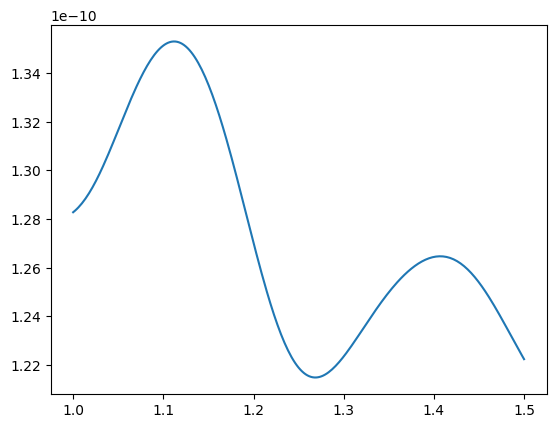

In [124]:
plt.plot(np.arange(powerdata.shape[0])/512+1,powerdata)